In [15]:
import os, sys
from os.path import join
import numpy as np
import matplotlib.pyplot as plt
from importlib import reload
import pickle

from skimage.feature import peak_local_max
from scipy.ndimage import gaussian_filter1d, gaussian_filter
from scipy.signal import medfilt

import utils2p

from tqdm import tqdm

In [2]:
NOTEBOOK_DIR = os.getcwd()
MODULE_DIR, _ = os.path.split(NOTEBOOK_DIR)
sys.path.append(MODULE_DIR)
OUTPUT_DIR = os.path.join(MODULE_DIR, "outputs")

In [3]:
from longterm import load, utils
from longterm import plot as myplt

In [4]:
fly_dirs = [
        os.path.join(load.NAS2_DIR_LH, "210722", "fly3"),  # high caff
        os.path.join(load.NAS2_DIR_LH, "210721", "fly3"),  # high caff
        os.path.join(load.NAS2_DIR_LH, "210723", "fly1"),  # low caff
        os.path.join(load.NAS2_DIR_LH, "210723", "fly2"),  # high caff
        os.path.join(load.NAS2_DIR_LH, "210718", "fly2"),  # starv

        os.path.join(load.NAS2_DIR_LH, "210719", "fly1"),  # sucr
        os.path.join(load.NAS2_DIR_LH, "210719", "fly2"),  # starv
        os.path.join(load.NAS2_DIR_LH, "210719", "fly4"),  # sucr
        os.path.join(load.NAS2_DIR_LH, "210802", "fly1"),  # lowcaff
        os.path.join(load.NAS2_DIR_LH, "210804", "fly1"),  # low caff

        os.path.join(load.NAS2_DIR_LH, "210804", "fly2"),  # low caff
        os.path.join(load.NAS2_DIR_LH, "210811", "fly2"),  # high caff
        os.path.join(load.NAS2_DIR_LH, "210811", "fly1"),  # starv
        os.path.join(load.NAS2_DIR_LH, "210812", "fly1"),  # starv
        os.path.join(load.NAS2_DIR_LH, "210813", "fly1"),  # sucr

        os.path.join(load.NAS2_DIR_LH, "210818", "fly3"),  # sucr
        ]

all_selected_trials = [
        [1,3,4,5,6,7,8,9,10,11,12,13],
        [1,3,4,5,6,7,8,9,10,11,12],
        [1,3,4,5,6,8,9,10,11,12],
        [1,3,5,6,7,8,9,10,11,12,14],  # 13 excluded because no camera-metadata
        [2,4,5,7],

        [2,4,5,7,8],
        [2,4,5,7],
        [2,4,5,7],
        [1,3,4,5,6,7,8,9,11,12],  # 10 exlcuded because CC out of center
        [1,3,4,5,6,7,8,9,10,11,12],

        [1,3,5,6,7,8,9,10,11,12],  # 4 excluded for now, because processing not yet ready
        [0,2,5,6,7,8,9,10,11,12,13,16],
        [2,4,5,7],
        [2,4,5,7],
        [2,5,6,8],
        
        [2,4,5,7],]

conditions = [
        "210722 fly 3 high caff",
        "210721 fly 3 high caff",
        "210723 fly 1 low caff",
        "210723 fly 2 high caff",
        "210718 fly 2 starv",

        "210719 fly 1 sucr",
        "210719 fly 2 starv",
        "210719 fly 4 sucr",
        "210802 fly 1 low caff",
        "210804 fly 1 low caff",

        "210804 fly 2 low caff",
        "210811 fly 2 high caff",
        "210811 fly 1 starv",
        "210812 fly 1 starv",
        "210813 fly 1 sucr",

        "210818 fly 3 sucr",
        ]


In [5]:
pkl_dirs = [join(fly_dir, "processed", "compare_trials.pkl") for fly_dir in fly_dirs]
summary_dicts = []
for pkl_dir in tqdm(pkl_dirs):
    with open(pkl_dir, "rb") as f:
        summary_dict = pickle.load(f)
        summary_dicts.append(summary_dict)

100%|██████████| 16/16 [00:10<00:00,  1.50it/s]


In [6]:
list(summary_dict.keys())

['dff_means',
 'dff_mean_diffs',
 'green_means',
 'green_mean_diffs',
 'green_means_raw',
 'green_mean_diffs_raw',
 'dff_stds',
 'dff_std_diffs',
 'green_stds',
 'green_std_diffs',
 'green_stds_raw',
 'green_std_diffs_raw',
 'dff_quants',
 'dff_quant_diffs',
 'green_quants',
 'green_quant_diffs',
 'green_quants_raw',
 'green_quant_diffs_raw',
 'dff_local_corrs',
 'dff_local_corr_diffs',
 'green_local_corrs',
 'green_local_corr_diffs',
 'green_local_corrs_raw',
 'green_local_corr_diffs_raw',
 'trials',
 'ref_trial']

In [7]:
sort_ind = [0,1,3,11, 2,8,9,10, 4,6,12,13, 5,7,14,15]
fly_dirs_sort = [fly_dirs[i] for i in sort_ind]
conditions_sort = [conditions[i] for i in sort_ind]
summary_dicts_sort = [summary_dicts[i] for i in sort_ind]

# test correction for uneven illumination due to the gut

In [71]:
i_fly = 0
i_trial = 1
summary_dict = summary_dicts[i_fly]
greens = summary_dict["green_means_raw"]
green = greens[i_trial]

In [79]:
green = np.mean(greens, axis=0)

In [81]:
green_med_filt = medfilt(green, kernel_size=(71,91))

In [82]:
green_filt = gaussian_filter(green_med_filt, sigma=3)

<IPython.core.display.Javascript object>


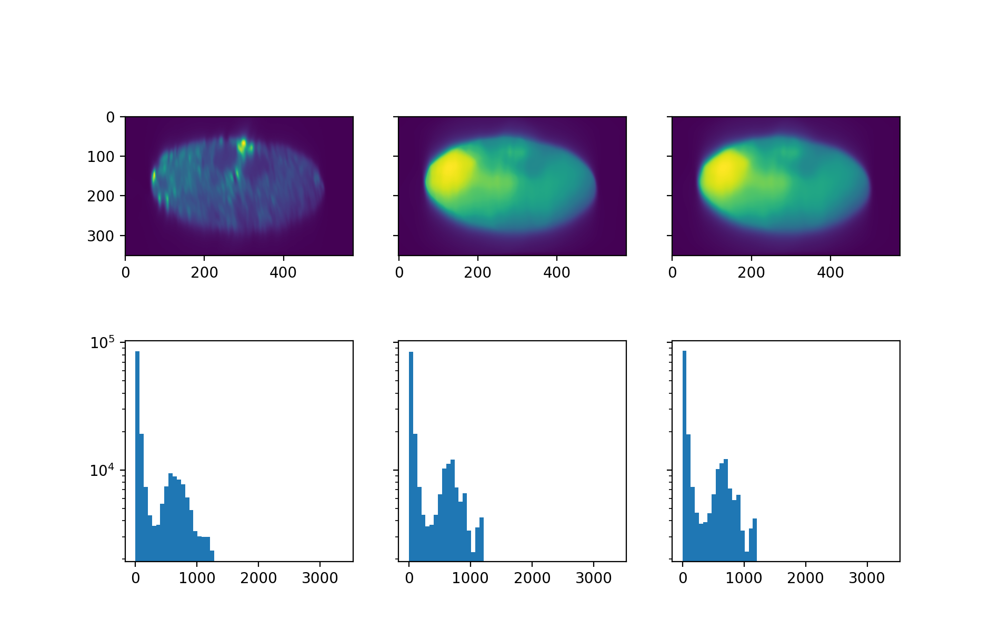

In [83]:
%matplotlib notebook
fig, axs = plt.subplots(2,3,figsize=(9.5,6), sharex="row", sharey="row")
axs[0,0].imshow(green)
axs[0,1].imshow(green_med_filt)
axs[0,2].imshow(green_filt)

n, bins, p = axs[1,0].hist(green.flatten(), bins=50)
axs[1,1].hist(green_med_filt.flatten(), bins=bins)
axs[1,2].hist(green_filt.flatten(), bins=bins)
_ = [ax.set_yscale("log") for ax in axs[1]]

<IPython.core.display.Javascript object>


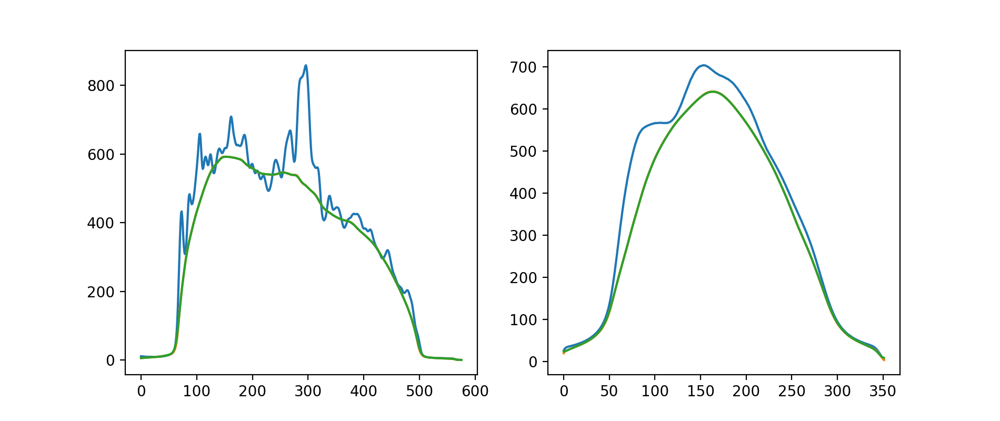

In [84]:
%matplotlib notebook
fig, axs = plt.subplots(1,2, figsize=(9.5,4))
axs[0].plot(np.mean(green, axis=0))
axs[0].plot(np.mean(green_med_filt, axis=0))
axs[0].plot(np.mean(green_filt, axis=0))

axs[1].plot(np.mean(green, axis=1))
axs[1].plot(np.mean(green_med_filt, axis=1))
axs[1].plot(np.mean(green_filt, axis=1))

In [85]:
y_mean = np.mean(green_filt, axis=0)
norm_range = [len(y_mean) // 2 - 100, len(y_mean) // 2 + 100]

In [86]:
y_target = y_mean[norm_range[0]:norm_range[1]]
x_target = np.arange(norm_range[0], norm_range[1])
# model: y = ax + b

X = np.hstack((np.expand_dims(x_target, axis=1), np.ones((len(x_target),1))))

b = np.linalg.pinv(X.T).T.dot(y_target)

In [87]:
b  # all trials

array([ -0.96891503, 772.66863053])

In [78]:
b  # trial 1

array([ -0.94259526, 697.60007089])

In [63]:
b  # trial 0

array([ -1.02155452, 761.12650279])

In [89]:
correction = 1/(1 +  b[0]/b[1]*np.arange(len(y_mean)))

<IPython.core.display.Javascript object>


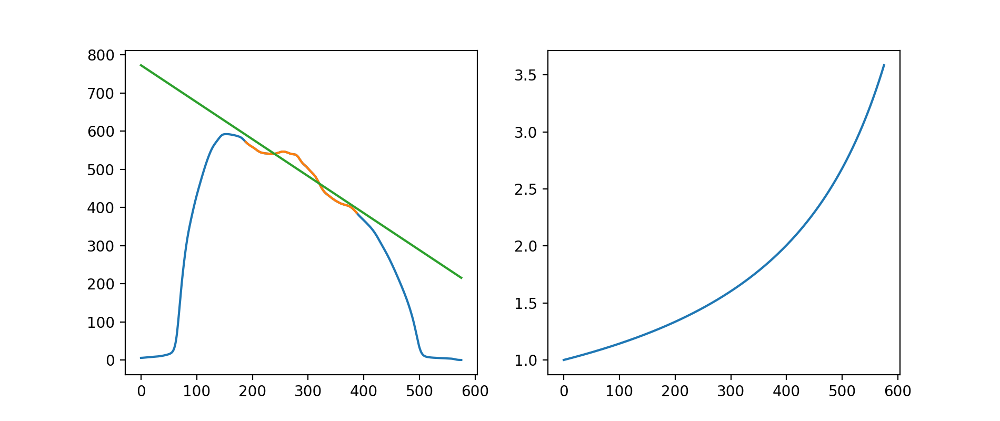

In [90]:
%matplotlib notebook
fig, axs = plt.subplots(1,2, figsize=(9.5,4), sharex=True)
axs[0].plot(y_mean)
axs[0].plot(x_target, y_target)

axs[0].plot(b[1] + b[0]*np.arange(len(y_mean)))

axs[1].plot(correction)
# axs[1].set_ylim([0,1])

In [91]:
green_corrected = green * correction

<IPython.core.display.Javascript object>


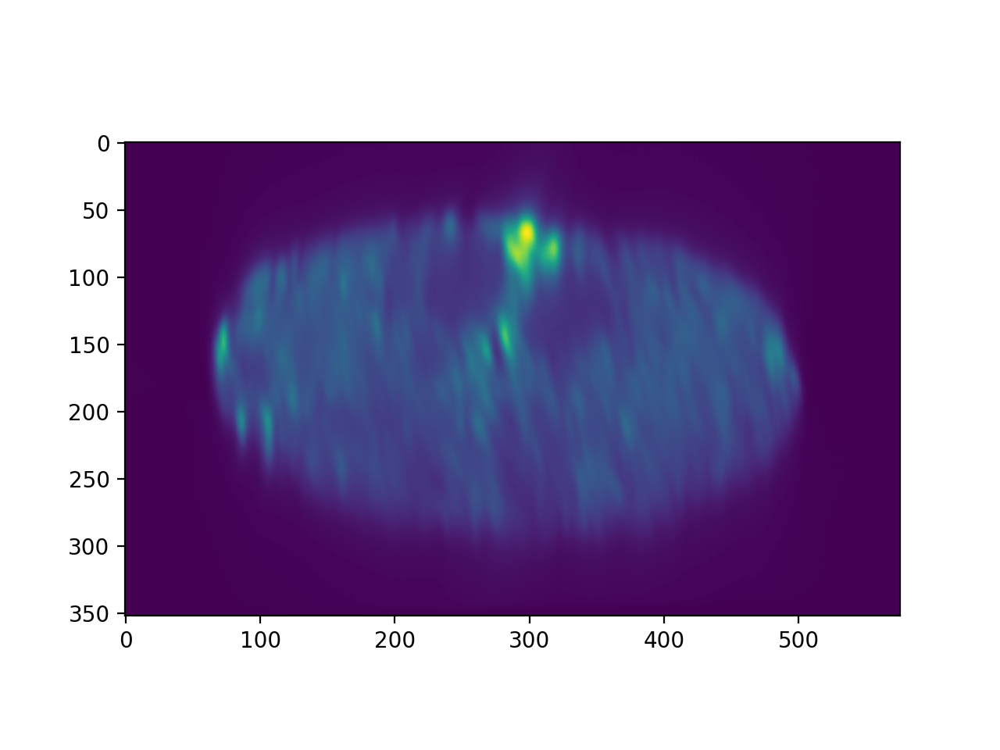

In [93]:
%matplotlib notebook
plt.imshow(green_corrected)

<IPython.core.display.Javascript object>


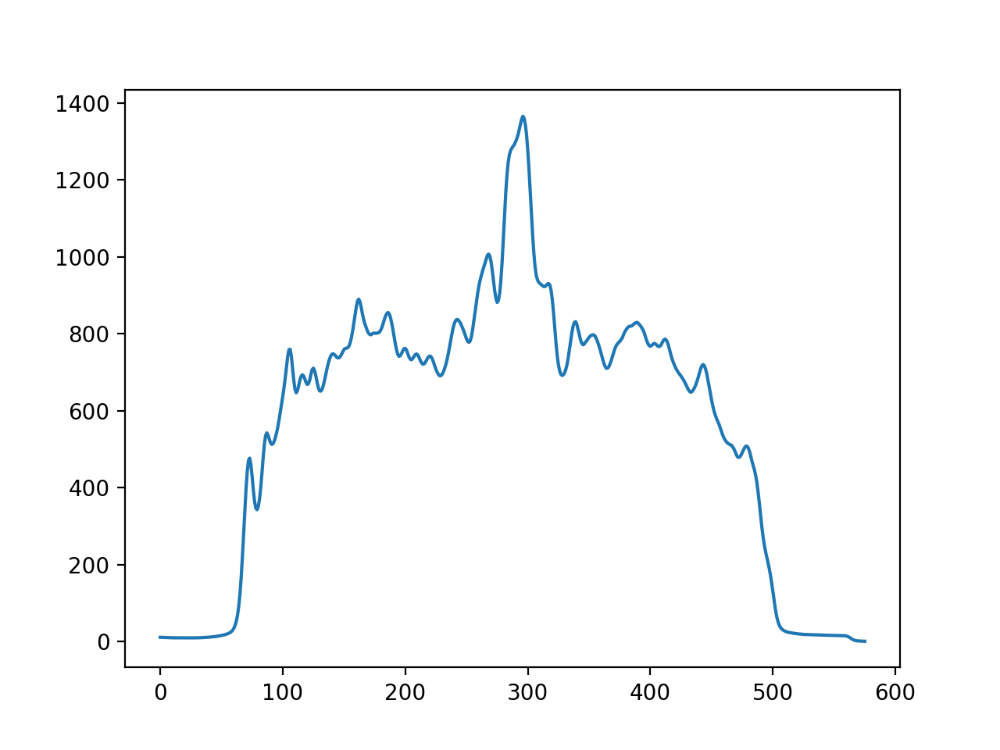

In [94]:
%matplotlib notebook
plt.plot(np.mean(green_corrected, axis=0))

In [96]:
green_fake_data = np.ones((1000, green.shape[0], green.shape[1]))
green_fake_data_corrected = green_fake_data * correction

<IPython.core.display.Javascript object>


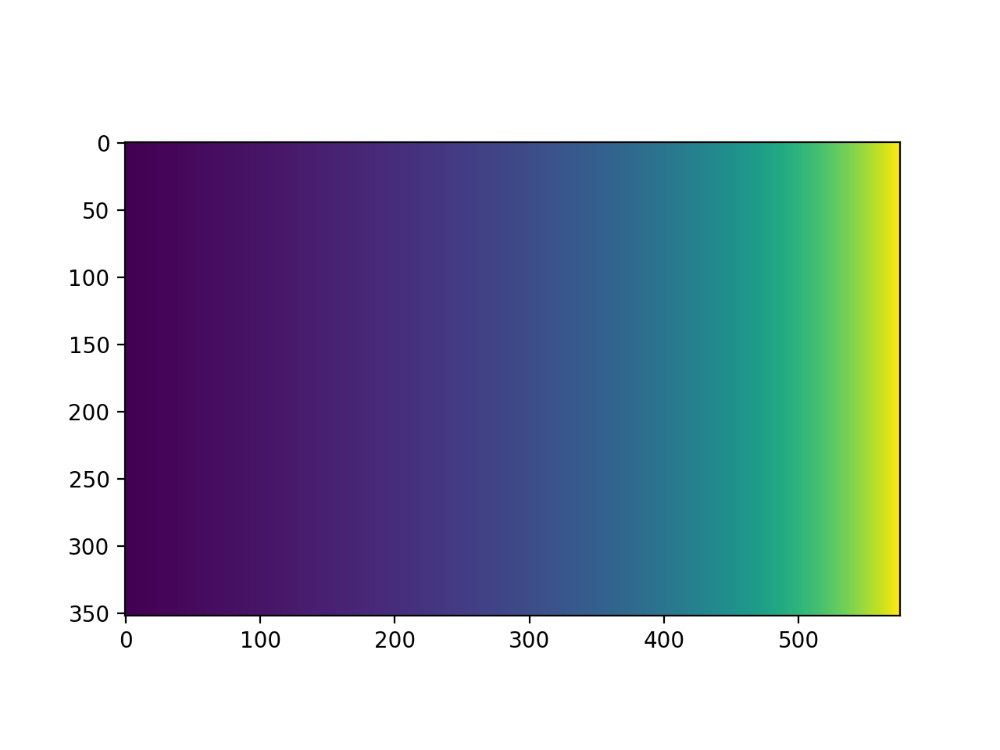

In [97]:
%matplotlib notebook
plt.imshow(np.mean(green_fake_data_corrected, axis=0))

# check whether the correction brought any improvement

In [118]:
"""
greens = [
    '/mnt/NAS2/LH/210722/fly3/cs_caff_after_007/processed/green_com_warped.tif',
    '/mnt/NAS2/JB/longterm/deep_interpolation_test/green_denoised_test_210722_fly3_cs_caff_after_007_1_1000_1.tif',
    '/mnt/NAS2/JB/longterm/deep_interpolation_test/green_denoised_test_210722_fly3_cs_caff_after_007_1_1000_2.tif',
    '/mnt/NAS2/JB/longterm/deep_interpolation_test/green_denoised_test_210722_fly3_cs_caff_after_007_1_2000_1.tif',
    '/mnt/NAS2/JB/longterm/deep_interpolation_test/green_denoised_test_210722_fly3_cs_caff_after_007_2_1000_1.tif',
    '/mnt/NAS2/JB/longterm/deep_interpolation_test/green_denoised_test_210722_fly3_cs_caff_after_007_1_2000_1_down2.tif',
    '/home/jbraun/tmp/deepinterpolation/data/210722_fly3_cs_caff_after_007_corrected',
    '/mnt/NAS2/JB/longterm/deep_interpolation_test/green_denoised_test_210722_fly3_cs_caff_after_007_1_2000_1_correct.tif',
]
"""
greens = [
    '/mnt/NAS2/LH/210722/fly3/cs_caff_after_007/processed/green_com_warped.tif',
    '/mnt/NAS2/JB/longterm/deep_interpolation_test/green_denoised_test_210722_fly3_cs_001_1_1000_1.tif',
    '/mnt/NAS2/JB/longterm/deep_interpolation_test/green_denoised_test_210722_fly3_cs_001_1_1000_2.tif',
    '/mnt/NAS2/JB/longterm/deep_interpolation_test/green_denoised_test_210722_fly3_cs_001_1_2000_1.tif',
    '/mnt/NAS2/JB/longterm/deep_interpolation_test/green_denoised_test_210722_fly3_cs_001_2_1000_1.tif',
    '/mnt/NAS2/JB/longterm/deep_interpolation_test/green_denoised_test_210722_fly3_cs_001_1_2000_1_down2.tif',
    '/home/jbraun/tmp/deepinterpolation/data/210722_fly3_cs_001_corrected',
    '/mnt/NAS2/JB/longterm/deep_interpolation_test/green_denoised_test_210722_fly3_cs_001_1_2000_1_correct.tif'
]

In [119]:
names = [
    'raw',
    'N_tr:1 N_fr:1000 N_x:1 ',
    'N_tr:1 N_fr:1000 N_x:2 ',
    'N_tr:1 N_fr:2000 N_x:1 ',
    'N_tr:2 N_fr:1000 N_x:1 ',
    'N_tr:1 N_fr:2000 N_x:1  down:2',
    'raw corrected',
    'N_tr:1 N_fr:2000 N_x:1  correct',
]

In [120]:
greens = [utils.get_stack(green) for green in greens]

In [121]:
green_stds = [np.std(green, axis=0) for green in greens]
green_means = [np.mean(green, axis=0) for green in greens]

In [122]:
del greens

In [123]:
from skimage.filters import threshold_otsu, threshold_local
from scipy.ndimage import gaussian_filter, binary_closing, binary_opening
from skimage.morphology import area_closing, area_opening, remove_small_holes, remove_small_objects, disk

<IPython.core.display.Javascript object>


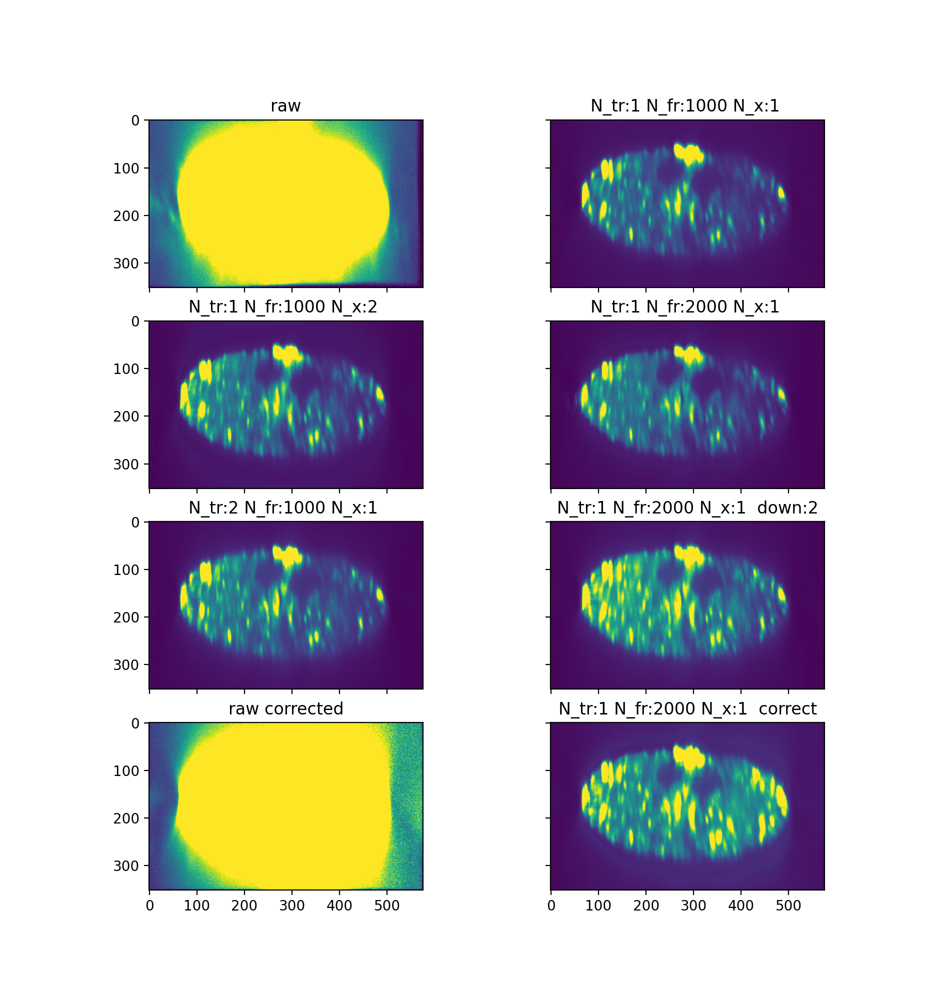

In [132]:
%matplotlib notebook
fig, axs = plt.subplots(4,2, figsize=(9.5,10), sharex=True, sharey=True)

clim = np.quantile(green_stds, 0.95)

for i_ax, (ax, green_std, name) in enumerate(zip(axs.flatten(), green_stds, names)):
    im = green_std
    thres = np.quantile(im, 0.6)
    im_thres = im > thres
    im_thres = binary_closing(im_thres, structure=np.ones((10,20)))
    im_thres = binary_opening(im_thres, structure=np.ones((30,30)))
    im_thres = binary_closing(im_thres, structure=np.ones((50,50)))    
    background_mean = np.mean(im[np.logical_not(im_thres)])
    
    # ax.imshow(green_std, clim=[0, clim])
    # ax.imshow(np.log10(im/background_mean), clim=[0,2])
    # ax.imshow(im/background_mean, clim=[0,10])
    # loc_clim = np.quantile(im, 0.95)
    ax.imshow(im, clim=[0, 0.25*clim])  # loc_clim
    # ax.plot(np.nanmean(np.log10(im/background_mean), axis=0))
    ax.set_title(name)

# analyse standard deviation of cervical connective

In [7]:
from skimage.filters import threshold_otsu, threshold_local
from scipy.ndimage import gaussian_filter, binary_closing, binary_opening
from skimage.morphology import area_closing, area_opening, remove_small_holes, remove_small_objects, disk

<IPython.core.display.Javascript object>


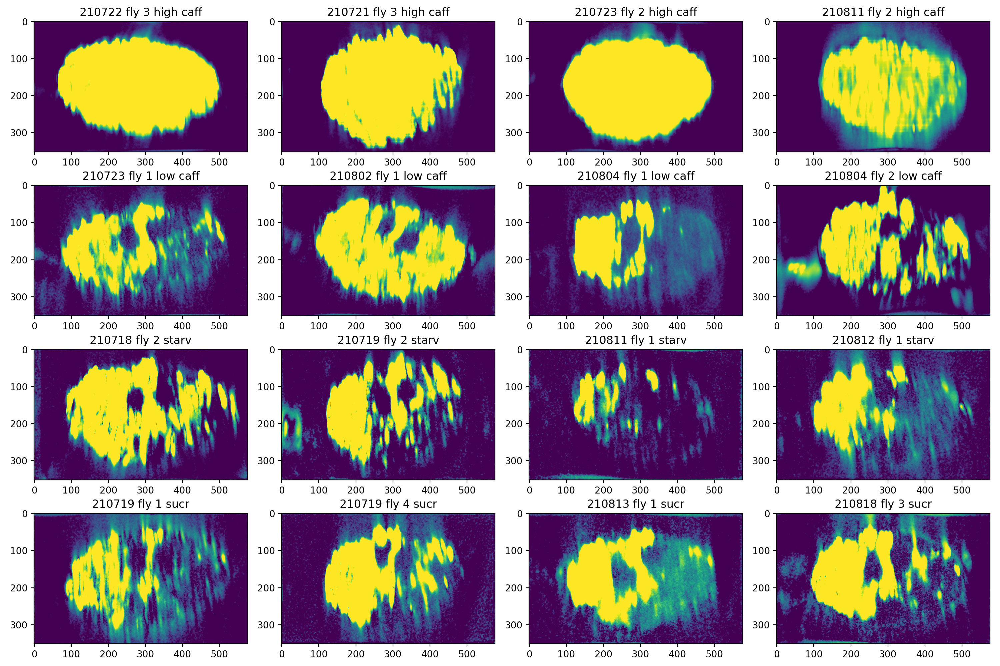

210722 fly 3 high caff: background mean: 2.181488037109375
210721 fly 3 high caff: background mean: 1.2632644176483154
210723 fly 2 high caff: background mean: 1.9781060218811035
210811 fly 2 high caff: background mean: 3.4419503211975098
210723 fly 1 low caff: background mean: 0.39708656072616577
210802 fly 1 low caff: background mean: 0.5680108070373535
210804 fly 1 low caff: background mean: 0.32189446687698364
210804 fly 2 low caff: background mean: 0.8580439686775208
210718 fly 2 starv: background mean: 0.629593551158905
210719 fly 2 starv: background mean: 0.45587703585624695
210811 fly 1 starv: background mean: 0.19537560641765594
210812 fly 1 starv: background mean: 0.40741974115371704
210719 fly 1 sucr: background mean: 0.5672224164009094
210719 fly 4 sucr: background mean: 0.3322902321815491
210813 fly 1 sucr: background mean: 0.23315589129924774
210818 fly 3 sucr: background mean: 0.3327558636665344


<IPython.core.display.Javascript object>


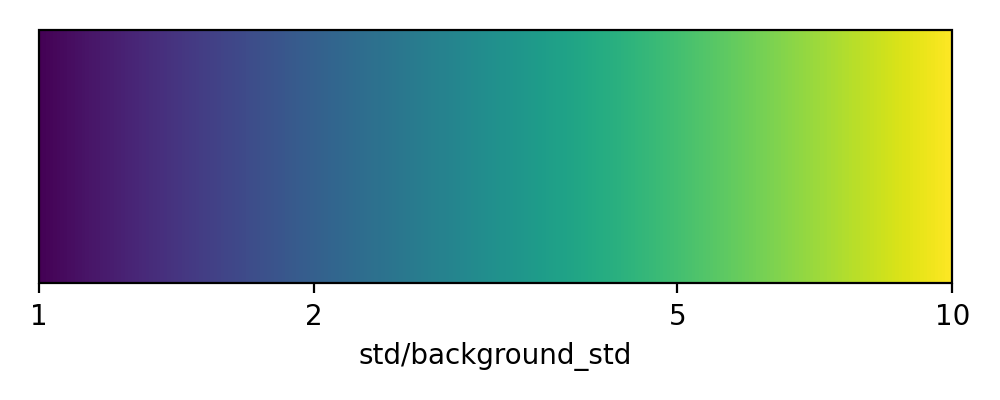

In [9]:
%matplotlib notebook
fig, axs = plt.subplots(4,4,figsize=(15,10))
for i_fly, (condition, summary_dict, ax) in enumerate(zip(conditions_sort, summary_dicts_sort, axs.flatten())):
    im = np.std(summary_dict["green_stds"], axis=0)
    # im = summary_dict["green_stds"][0]
    # thres = threshold_local(gaussian_filter(im, sigma=100), block_size=81)
    thres = np.quantile(im, 0.6)
    im_thres = im > thres
    im_thres = binary_closing(im_thres, structure=np.ones((10,20)))
    im_thres = binary_opening(im_thres, structure=np.ones((30,30)))
    im_thres = binary_closing(im_thres, structure=np.ones((50,50)))
    
    # utils.save_stack(os.path.join(fly_dirs_sort[i_fly], "processed", "cc_mask.tif"), im_thres)
    
    background_mean = np.mean(im[np.logical_not(im_thres)])
    print(f"{condition}: background mean: {background_mean}")
    
    # thres = threshold_local(gaussian_filter(np.log10(im/background_mean), sigma=100), block_size=81)
    thres = 0.9 * threshold_otsu(gaussian_filter(np.log10(im/background_mean), sigma=300))
    im_thres = np.log10(im/background_mean) > 0.3  # thres
    im_thres = binary_closing(im_thres, structure=disk(3))
    im_thres = remove_small_objects(im_thres, min_size=512)
    im_thres = remove_small_holes(im_thres, area_threshold=4096)
    
    
    
    
    # utils.save_stack(os.path.join(fly_dirs_sort[i_fly], "processed", "dff_mask_denoised_t1.tif"), im_thres)
    # imobj = ax.imshow(np.log10(im/background_mean)+10*im_thres, clim=[0,1])
    imobj = ax.imshow(np.log10(im/background_mean), clim=[0,1])  # [0, np.quantile(im, 0.9)])
    ax.set_title(condition)
fig.tight_layout()

fig2, ax = plt.subplots(1,1,figsize=(5,2))
cbar = fig2.colorbar(imobj, cax=ax, orientation='horizontal', label="std/background_std")
cbar.set_ticks(np.log10([1,2,5,10]))
cbar.set_ticklabels([1,2,5,10])
fig2.tight_layout()
# axs.flatten()[-1].axis("off")
# axs.flatten()[-2].axis("off")


In [11]:
locations = ["top two neurons", "top outside region", "bottom region", "giant fibers"]
roi_centers = [
    [[(65,270), (65,283), (90,295), (75,305), (80,320)], [(140,425), (130,150)], [(240,300)], [(110,250), (130,325)]],  # 210722 fly 3 high caff
    [[(65,265), (40,292), (55,325), (55,355), (68,375)], [(140,425), (130,170)], [(250,300)], [(105,270), (120,340)]],  # 210721 fly 3 high caff
    [[(75,275), (75,295), (85,310), (65,325), (70,337)], [(140,420), (140,180)], [(240,300)], [(120,270), (140,325)]],  # 210723 fly 2 high caff
    [[(62,292), (65,306), (75,347), (80,358), (105,327)],[(160,450), (140,180)], [(250,300)], [(110,290), (140,350)]],  # 210811 fly 2 high caff
              ]
roi_radii = [
    [[5,3,5,5,5],[40,40],[60],[10,10]],  # 210722 fly 3 high caff
    [[5,5,5,3,3],[40,40],[60],[10,10]],  # 210721 fly 3 high caff
    [[3,5,5,5,3],[40,40],[60],[10,10]],  # 210723 fly 2 high caff
    [[3,3,3,3,5],[40,40],[60],[10,10]],  # 210811 fly 2 high caff
              ]

<IPython.core.display.Javascript object>


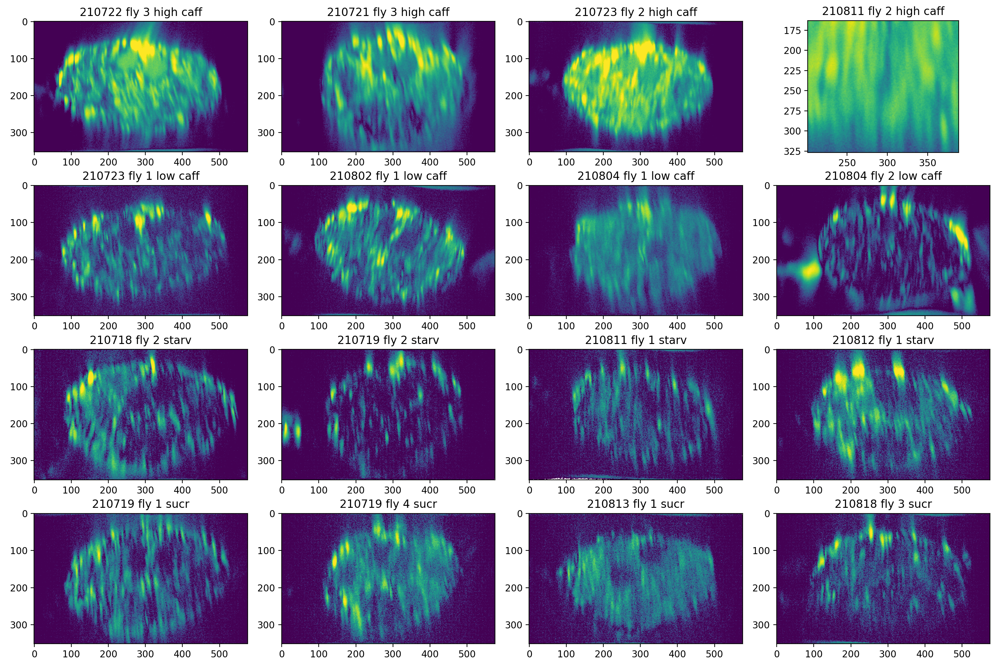

210722 fly 3 high caff: background mean: 24.267829430895873
210721 fly 3 high caff: background mean: 25.43323431463957
210723 fly 2 high caff: background mean: 21.795246423311262
210811 fly 2 high caff: background mean: 31.69467555391916
210723 fly 1 low caff: background mean: 14.431709577792235
210802 fly 1 low caff: background mean: 16.289612899185332
210804 fly 1 low caff: background mean: 16.837433059789063
210804 fly 2 low caff: background mean: 20.57038889122227
210718 fly 2 starv: background mean: 15.382035959872288
210719 fly 2 starv: background mean: 17.4738699836963


/home/jbraun/anaconda3/envs/longterm37/lib/python3.7/site-packages/ipykernel_launcher.py:19: RuntimeWarning: divide by zero encountered in log10
/home/jbraun/anaconda3/envs/longterm37/lib/python3.7/site-packages/ipykernel_launcher.py:20: RuntimeWarning: divide by zero encountered in log10
/home/jbraun/anaconda3/envs/longterm37/lib/python3.7/site-packages/ipykernel_launcher.py:30: RuntimeWarning: divide by zero encountered in log10


210811 fly 1 starv: background mean: 13.942275092589918
210812 fly 1 starv: background mean: 13.51570807190621
210719 fly 1 sucr: background mean: 15.998485985729548
210719 fly 4 sucr: background mean: 13.53210846119094
210813 fly 1 sucr: background mean: 13.081589969510064
210818 fly 3 sucr: background mean: 14.401857123474299


<IPython.core.display.Javascript object>


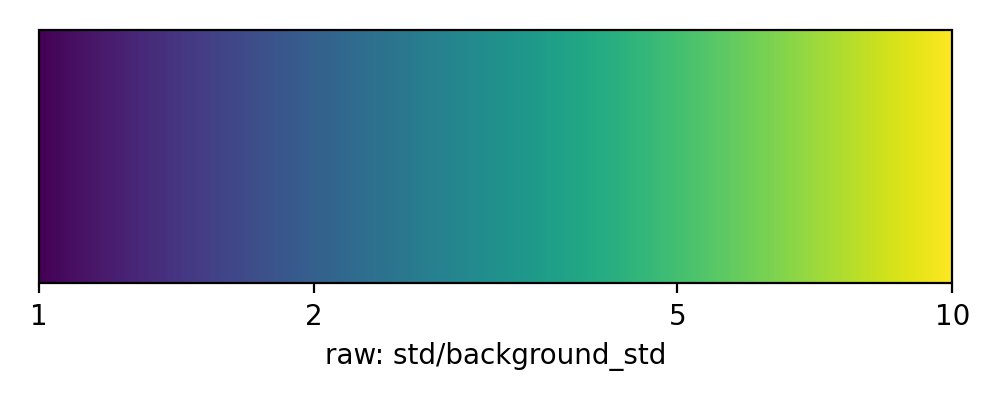

In [10]:
%matplotlib notebook
fig, axs = plt.subplots(4,4,figsize=(15,10))
for i_fly, (condition, summary_dict, ax) in enumerate(zip(conditions_sort, summary_dicts_sort, axs.flatten())):
    im = np.std(summary_dict["green_stds_raw"], axis=0)
    # im = summary_dict["green_stds"][0]
    # thres = threshold_local(gaussian_filter(im, sigma=100), block_size=81)
    thres = np.quantile(im, 0.6)
    im_thres = im > thres
    im_thres = binary_closing(im_thres, structure=np.ones((10,20)))
    im_thres = binary_opening(im_thres, structure=np.ones((30,30)))
    im_thres = binary_closing(im_thres, structure=np.ones((50,50)))
    
    # utils.save_stack(os.path.join(fly_dirs_sort[i_fly], "processed", "cc_mask.tif"), im_thres)
    
    background_mean = np.mean(im[np.logical_not(im_thres)])
    print(f"{condition}: background mean: {background_mean}")
    
    # thres = threshold_local(gaussian_filter(np.log10(im/background_mean), sigma=100), block_size=81)
    thres = 2 * threshold_otsu(gaussian_filter(np.log10(im/background_mean), sigma=300))
    im_thres = np.log10(im/background_mean) > 0.3  # thres
    im_thres = binary_closing(im_thres, structure=disk(2))
    im_thres = remove_small_objects(im_thres, min_size=1024)
    im_thres = remove_small_holes(im_thres, area_threshold=4096)
    
    
    
    # print(os.path.join(fly_dirs_sort[i_fly], "processed", "dff_mask_raw.tif"))
    # utils.save_stack(os.path.join(fly_dirs_sort[i_fly], "processed", "dff_mask_raw.tif"), im_thres)
    # imobj = ax.imshow(np.log10(im/background_mean)+10*im_thres, clim=[0,1])
    imobj = ax.imshow(np.log10(im/background_mean), clim=[0,1])  # [0, np.quantile(im, 0.9)])
    ax.set_title(condition)
fig.tight_layout()

fig2, ax = plt.subplots(1,1,figsize=(5,2))
cbar = fig2.colorbar(imobj, cax=ax, orientation='horizontal', label="raw: std/background_std")
cbar.set_ticks(np.log10([1,2,5,10]))
cbar.set_ticklabels([1,2,5,10])
fig2.tight_layout()
# axs.flatten()[-1].axis("off")
# axs.flatten()[-2].axis("off")



<IPython.core.display.Javascript object>


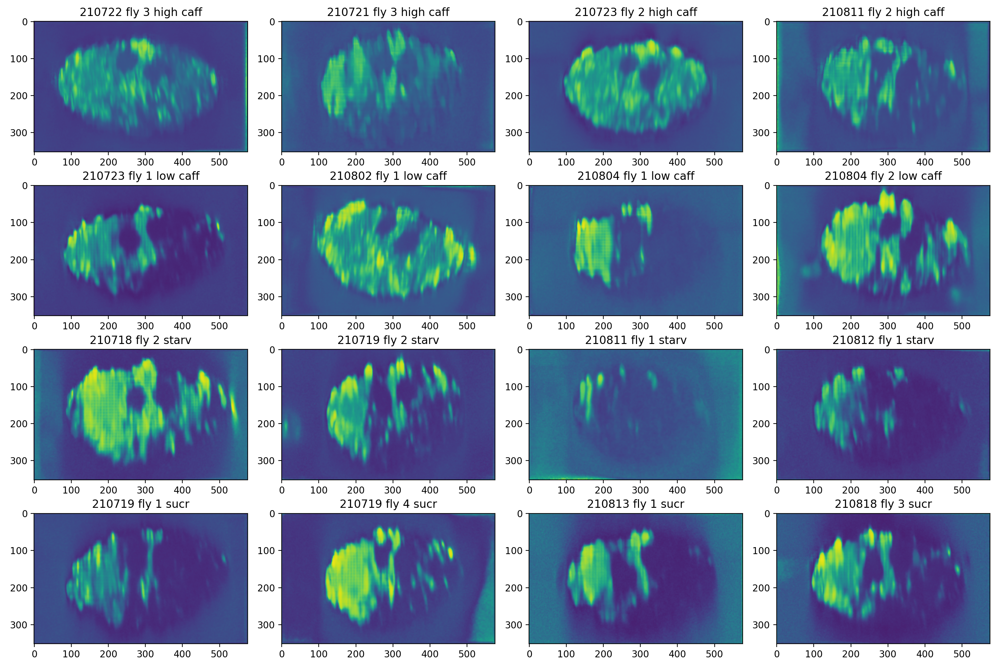

<IPython.core.display.Javascript object>


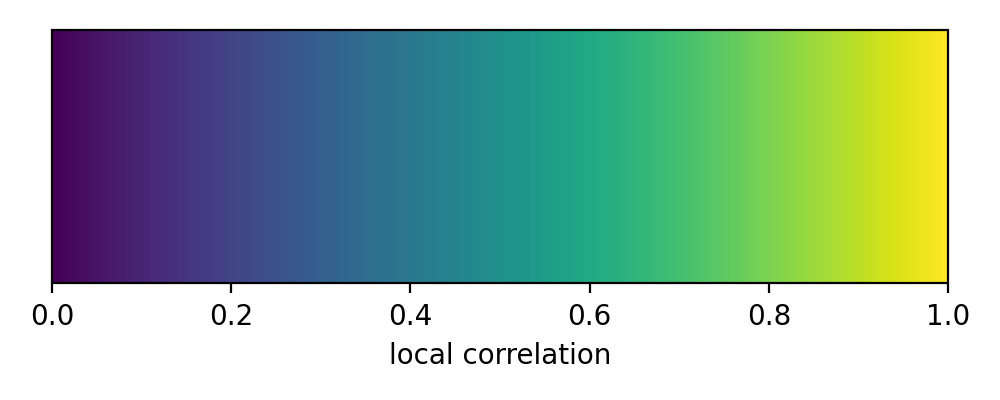

In [20]:
%matplotlib notebook
fig, axs = plt.subplots(4,4,figsize=(15,10))
for i_fly, (condition, summary_dict, ax) in enumerate(zip(conditions_sort, summary_dicts_sort, axs.flatten())):
    im = np.mean(summary_dict["green_local_corrs"], axis=0)
    ax.imshow(im, clim=[0,1])  # clim=[0, np.quantile(im, 0.9)])
    ax.set_title(condition)
fig.tight_layout()

fig2, ax = plt.subplots(1,1,figsize=(5,2))
cbar = fig2.colorbar(imobj, cax=ax, orientation='horizontal', label="local correlation")
# cbar.set_ticks(np.log10([1,2,5,10]))
# cbar.set_ticklabels([1,2,5,10])
fig2.tight_layout()

# plotting waves

In [96]:
# for i_trials, fly_dir, condition in zip(all_selected_trials, fly_dirs, conditions):
i_fly = 0
condition = conditions[0]
i_trials = all_selected_trials[0]
fly_dir = fly_dirs[0]
if "caff" in condition:
    all_trial_dirs = utils.readlines_tolist(os.path.join(fly_dir, "trial_dirs.txt"))
    trial_dirs = [this_dir for i_trial, this_dir in enumerate(all_trial_dirs) if i_trial in i_trials]
trial_names = []
for trial_dir in trial_dirs:
    _, name = os.path.split(trial_dir)
    trial_names.append(name)
trial_names

['cs_001',
 'cs_003',
 'cs_caff',
 'cs_caff_after',
 'cs_caff_after_001',
 'cs_caff_after_002',
 'cs_caff_after_003',
 'cs_caff_after_004',
 'cs_caff_after_005',
 'cs_caff_after_006',
 'cs_caff_after_007',
 'cs_caff_after_008']

In [97]:
green_dirs = [os.path.join(trial_dir, "processed", "green_denoised_t1.tif") for trial_dir in trial_dirs]
greens = [utils.get_stack(green_dir) for green_dir in green_dirs]

In [114]:
mask = utils.get_stack(os.path.join(fly_dir, "processed", "cc_mask.tif")) > 0
N_pixels = np.sum(mask)

In [115]:
green_means = np.array([np.sum(green*mask, axis=(1,2))/N_pixels for green in greens]).T

In [117]:
green_means.shape

(3840, 12)

<IPython.core.display.Javascript object>


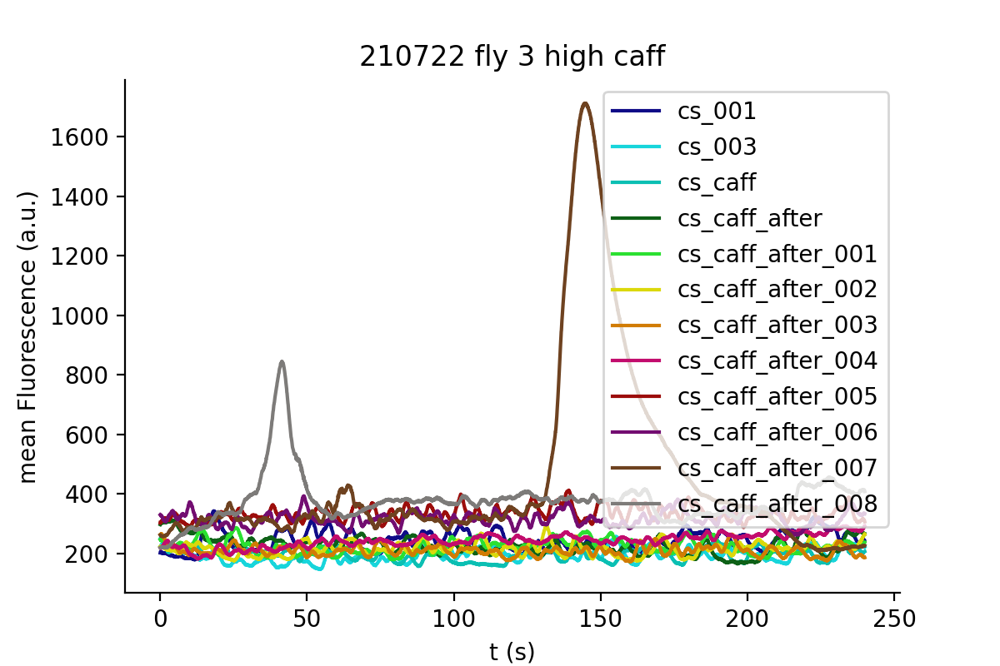

In [120]:
%matplotlib notebook
fig, ax = plt.subplots(1,1, figsize=(6,4))


colors_long = [myplt.DARKBLUE, myplt.DARKBLUE_CONTRAST, myplt.DARKCYAN, myplt.DARKGREEN, myplt.DARKGREEN_CONTRAST, 
               myplt.DARKYELLOW, myplt.DARKORANGE, myplt.DARKPINK, myplt.DARKRED, myplt.DARKPURPLE, myplt.DARKBROWN, myplt.DARKGRAY, myplt.BLACK]

t = np.arange(len(green_means)) / 16
for line, c, name in zip(green_means.T, colors_long, trial_names):
    ax.plot(t, line, color=c, label=name)
    
ax.legend()
ax.set_xlabel("t (s)")
ax.set_ylabel("mean Fluorescence (a.u.)")
ax.set_title(condition)
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

In [5]:
from tqdm import tqdm

In [6]:
from longterm.rois import get_dff_from_traces

16it [11:54, 44.63s/it]


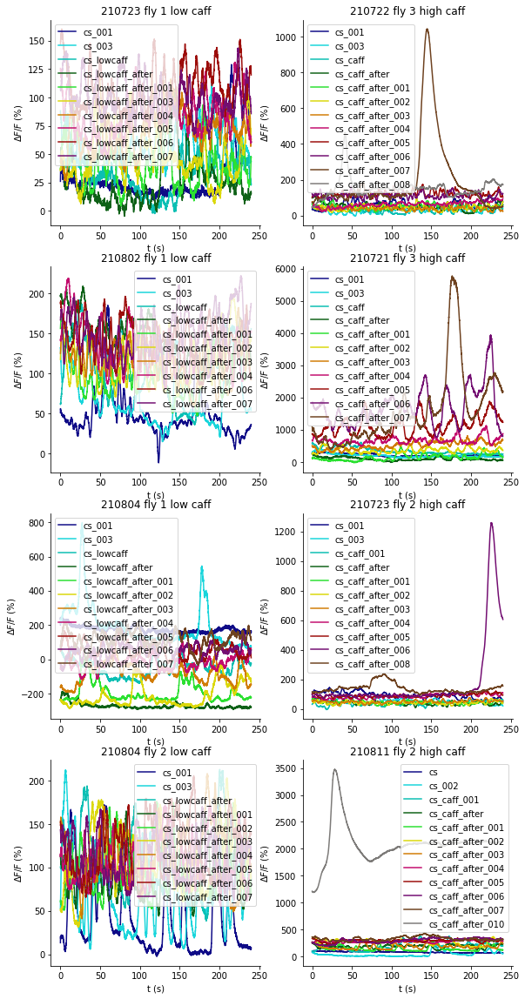

In [15]:
fig, axs = plt.subplots(4,2, figsize=(9.5,20))
i_low = -1
i_high = -1
colors_long = [myplt.DARKBLUE, myplt.DARKBLUE_CONTRAST, myplt.DARKCYAN, myplt.DARKGREEN, myplt.DARKGREEN_CONTRAST, 
               myplt.DARKYELLOW, myplt.DARKORANGE, myplt.DARKPINK, myplt.DARKRED, myplt.DARKPURPLE, myplt.DARKBROWN, myplt.DARKGRAY, myplt.BLACK]


for i_trials, fly_dir, condition in tqdm(zip(all_selected_trials, fly_dirs, conditions)):
    if "caff" in condition:
        if "low" in condition:
            i_low += 1
            i_col = 0
            i_row = i_low
        else:
            i_high += 1
            i_col = 1
            i_row = i_high
        all_trial_dirs = utils.readlines_tolist(os.path.join(fly_dir, "trial_dirs.txt"))
        trial_dirs = [this_dir for i_trial, this_dir in enumerate(all_trial_dirs) if i_trial in i_trials]
        trial_names = []
        for trial_dir in trial_dirs:
            _, name = os.path.split(trial_dir)
            trial_names.append(name)
        green_dirs = [os.path.join(trial_dir, "processed", "green_denoised_t1.tif") for trial_dir in trial_dirs]
        greens = [utils.get_stack(green_dir) for green_dir in green_dirs]
        mask = utils.get_stack(os.path.join(fly_dir, "processed", "cc_mask.tif")) > 0
        N_pixels = np.sum(mask)
        green_means = np.array([np.sum(green*mask, axis=(1,2))/N_pixels for green in greens]).T
        
        _, f0s = get_dff_from_traces(green_means, return_f0=True, length_baseline=50, f0_min=10)
        f0 = f0s.min()
        dffs = 100*(green_means - f0) / f0
        
        ax = axs[i_row, i_col]
        t = np.arange(len(green_means)) / 16
        for line, c, name in zip(dffs.T, colors_long, trial_names):
            ax.plot(t, line, color=c, label=name)

        ax.legend()
        ax.set_xlabel("t (s)")
        ax.set_ylabel(r"$\Delta F/F$ (%)")  # mean Fluorescence (a.u.)")
        ax.set_title(condition)
        ax.spines["top"].set_visible(False)
        ax.spines["right"].set_visible(False)
        del greens

In [16]:
fig.set_size_inches(25, 30)

In [18]:
for ax in axs.flatten():
    ax.legend().set_visible(False)

In [19]:
fig.tight_layout()

In [21]:
fig.savefig(os.path.join(OUTPUT_DIR, "210824_waves.png"), dpi=100)


# plotting detailled waves of specific ROIs

In [8]:
locations = ["top two neurons", "top outside region", "bottom region", "giant fibers"]
roi_centers = [
    [[(65,270), (65,283), (90,295), (75,305), (80,320)], [(140,425), (130,150)], [(240,300)], [(110,250), (130,325)]],  # 210722 fly 3 high caff
    [[(65,265), (40,292), (55,325), (55,355), (68,375)], [(140,425), (130,170)], [(250,300)], [(105,270), (120,340)]],  # 210721 fly 3 high caff
    [[(75,275), (75,295), (85,310), (65,325), (70,337)], [(140,420), (140,180)], [(240,300)], [(120,270), (140,325)]],  # 210723 fly 2 high caff
    [[(62,292), (65,306), (75,347), (80,358), (105,327)],[(160,450), (140,180)], [(250,300)], [(110,290), (140,350)]],  # 210811 fly 2 high caff
              ]
roi_radii = [
    [[5,3,5,5,5],[40,40],[60],[10,10]],  # 210722 fly 3 high caff
    [[5,5,5,3,3],[40,40],[60],[10,10]],  # 210721 fly 3 high caff
    [[3,5,5,5,3],[40,40],[60],[10,10]],  # 210723 fly 2 high caff
    [[3,3,3,3,5],[40,40],[60],[10,10]],  # 210811 fly 2 high caff
]

In [9]:
i_fly = 11 # 3  # 1  # 0
i_highcafffly = 3  # 2  # 1  # 0
fly_dir = fly_dirs[i_fly]
i_trials = all_selected_trials[i_fly]
condition = conditions[i_fly]
fly_roi_centers = roi_centers[i_highcafffly]
fly_roi_radii = roi_radii[i_highcafffly]


In [10]:
all_trial_dirs = utils.readlines_tolist(os.path.join(fly_dir, "trial_dirs.txt"))
trial_dirs = [this_dir for i_trial, this_dir in enumerate(all_trial_dirs) if i_trial in i_trials]
trial_names = []
for trial_dir in trial_dirs:
    _, name = os.path.split(trial_dir)
    trial_names.append(name)
green_dirs = [os.path.join(trial_dir, "processed", "green_denoised_t1.tif") for trial_dir in trial_dirs]

In [11]:
greens = [utils.get_stack(green_dir) for green_dir in tqdm(green_dirs)]
mask = utils.get_stack(os.path.join(fly_dir, "processed", "cc_mask.tif")) > 0

100%|██████████| 12/12 [01:20<00:00,  6.72s/it]


In [12]:
from longterm.rois import get_dff_from_traces

In [13]:
N_pixels = np.sum(mask)
green_means = np.array([np.sum(green*mask, axis=(1,2))/N_pixels for green in greens]).T

_, f0s = get_dff_from_traces(green_means, return_f0=True, length_baseline=50, f0_min=10)
f0 = f0s.min()
dffs = 100*(green_means - f0) / f0

<IPython.core.display.Javascript object>


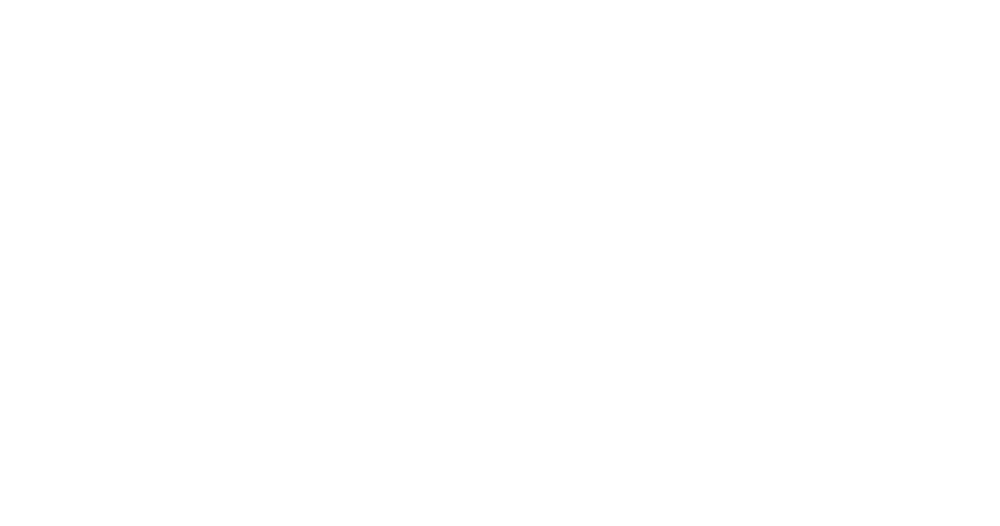

In [14]:
%matplotlib notebook
colors_long = [myplt.DARKBLUE, myplt.DARKBLUE_CONTRAST, myplt.DARKCYAN, myplt.DARKGREEN, myplt.DARKGREEN_CONTRAST, 
               myplt.DARKYELLOW, myplt.DARKORANGE, myplt.DARKPINK, myplt.DARKRED, myplt.DARKPURPLE, myplt.DARKBROWN, myplt.DARKGRAY, myplt.BLACK]

fig, ax = plt.subplots(1,1,figsize=(9.5,5))
t = np.arange(len(green_means)) / 16
for line, c, name in zip(dffs.T, colors_long, trial_names):
    ax.plot(t, line, color=c, label=name)

ax.legend()
ax.set_xlabel("t (s)")
ax.set_ylabel(r"$\Delta F/F$ (%)")  # mean Fluorescence (a.u.)")
ax.set_title(condition)
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)

In [15]:
i_trial = -2
green = greens[i_trial]
green_mean = green_means.T[i_trial]
dff = dffs.T[i_trial]

In [16]:
from scipy.signal import convolve2d
from skimage.morphology import disk

In [17]:
roi_masks = []
for i_loc, (loc_roi_centers, loc_roi_radii) in enumerate(zip(fly_roi_centers, fly_roi_radii)):
    loc_masks = []
    for i_roi, (roi_center, roi_radius) in enumerate(zip(loc_roi_centers, loc_roi_radii)):
        mask = np.zeros(green.shape[1:])
        mask[roi_center[0], roi_center[1]] = 1
        kernel = disk(roi_radius)
        mask = convolve2d(mask,kernel, mode="same")
        mask = mask > 0
        loc_masks.append(mask)
    roi_masks.append(loc_masks)
    
    
    

<IPython.core.display.Javascript object>


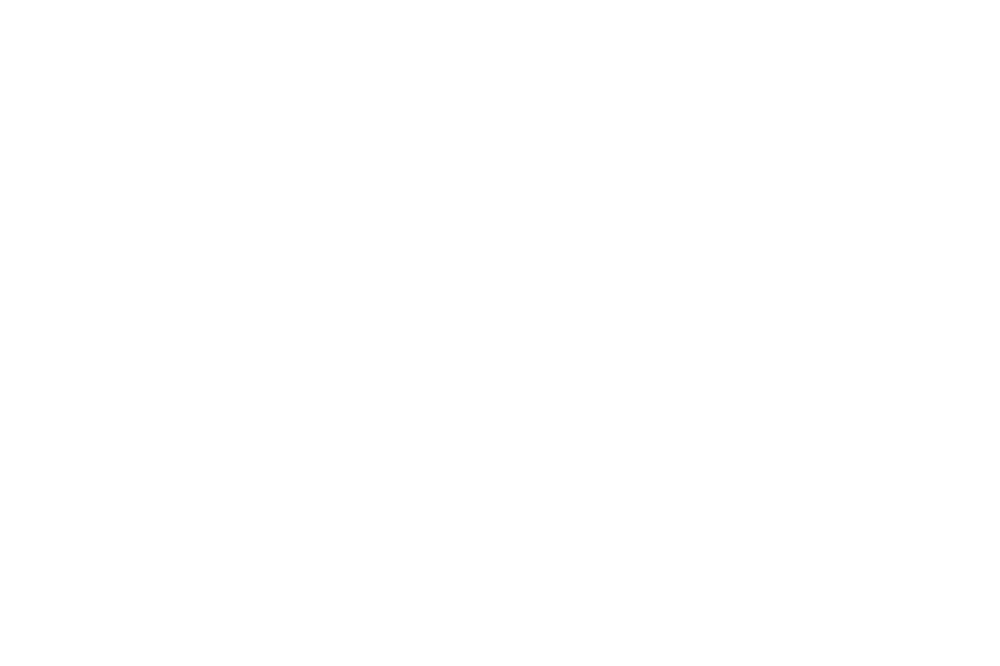

In [18]:
%matplotlib notebook
colors_long = [myplt.DARKBLUE, myplt.DARKBLUE_CONTRAST, myplt.DARKCYAN, myplt.DARKGREEN, myplt.DARKGREEN_CONTRAST, 
               myplt.DARKYELLOW, myplt.DARKORANGE, myplt.DARKPINK, myplt.DARKRED, myplt.DARKPURPLE, myplt.DARKBROWN, myplt.DARKGRAY, myplt.BLACK]


i_colors = [0,3,5,8]

im = np.std(summary_dicts[i_fly]["green_stds_raw"], axis=0)


fig, ax = plt.subplots(1,1, figsize=(6,4))
plt.imshow(im, cmap=plt.cm.get_cmap("gray"), clim=[0, np.quantile(im, 0.99)])
for i_loc, (loc_roi_centers, loc_roi_radii) in enumerate(zip(fly_roi_centers, fly_roi_radii)):
    for i_roi, (roi_center, roi_radius) in enumerate(zip(loc_roi_centers, loc_roi_radii)):
        if i_loc == 0:
            alpha = 1 - i_roi / len(loc_roi_radii)
        else:
            alpha = 1
        circ = plt.Circle((roi_center[1], roi_center[0]), roi_radius, fc=colors_long[i_colors[i_loc]], alpha=alpha)
        ax.add_patch(circ)
ax.set_title(condition)
fig.tight_layout()

In [19]:
green_roi_means = []
dffs_roi_means = []
for i_loc, loc_masks in enumerate(roi_masks):
    loc_means = []
    loc_dffs = []
    for i_mask, mask in enumerate(loc_masks):
        this_green_mean = np.array([np.sum(green*mask, axis=(1,2))/np.sum(mask) for green in greens]).T
        loc_means.append(this_green_mean)
        
        _, this_f0s = get_dff_from_traces(this_green_mean, return_f0=True, length_baseline=50, f0_min=10)
        this_f0 = this_f0s.min()
        this_dffs = 100*(this_green_mean - this_f0) / this_f0
        loc_dffs.append(this_dffs)
        
    green_roi_means.append(loc_means)
    dffs_roi_means.append(loc_dffs)



<IPython.core.display.Javascript object>


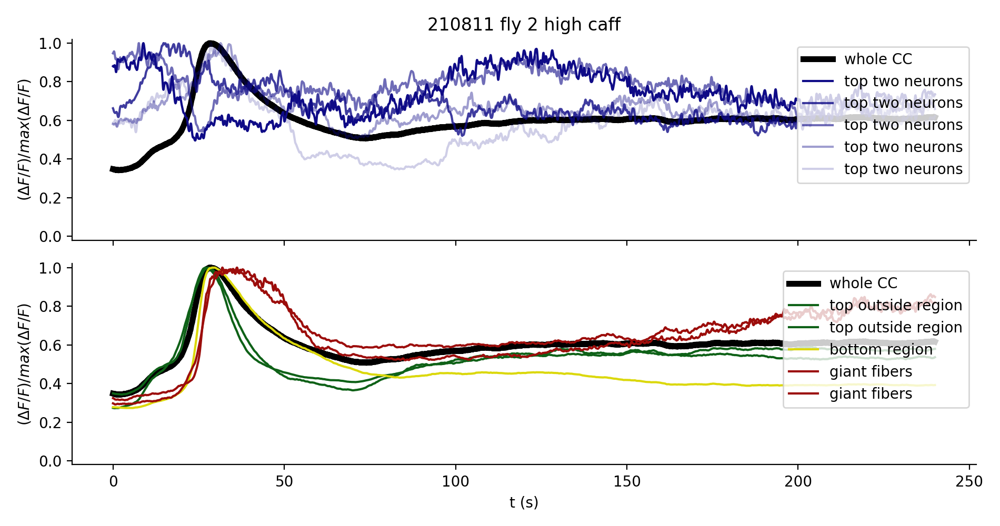

In [23]:
%matplotlib notebook
colors_long = [myplt.DARKBLUE, myplt.DARKBLUE_CONTRAST, myplt.DARKCYAN, myplt.DARKGREEN, myplt.DARKGREEN_CONTRAST, 
               myplt.DARKYELLOW, myplt.DARKORANGE, myplt.DARKPINK, myplt.DARKRED, myplt.DARKPURPLE, myplt.DARKBROWN, myplt.DARKGRAY, myplt.BLACK]

fig, axs = plt.subplots(2,1,figsize=(9.5,5), sharex=True, sharey=True)
t = np.arange(len(green_mean)) / 16

i_trial = -1

dff = dffs.T[i_trial]
_ = [ax.plot(t, dff/dff.max(), color=myplt.BLACK, label="whole CC", linewidth=4) for ax in axs] # dff, green_mean

for i_loc, loc_means in enumerate(dffs_roi_means):  # green_roi_means
    for i_mask, this_green_mean in enumerate(loc_means):
        signal = gaussian_filter1d(this_green_mean.T[i_trial], sigma=3)
        if i_loc == 0:
            alpha = 1 - i_mask / len(loc_means)
            axs[0].plot(t, signal/signal.max(), color=colors_long[i_colors[i_loc]], label=locations[i_loc], alpha=alpha)
        else:
            axs[1].plot(t, signal/signal.max(), color=colors_long[i_colors[i_loc]], label=locations[i_loc])

_ = [ax.legend(loc="upper right") for ax in axs]
axs[0].set_ylim(-0.02,1.02)
axs[1].set_xlabel("t (s)")
_ = [ax.set_ylabel(r"$(\Delta F/F) / max(\Delta F/F)$") for ax in axs] # mean Fluorescence (a.u.)")
axs[0].set_title(condition)
_ = [ax.spines["top"].set_visible(False) for ax in axs]
_ = [ax.spines["right"].set_visible(False) for ax in axs]
fig.tight_layout()

In [24]:

dff = dffs.T[i_trial]
global_max = np.argmax(dff, axis=0)
t_diff = 16*10
time_range = [global_max-t_diff, global_max+t_diff]

In [25]:
green = greens[i_trial]
green_filt = gaussian_filter1d(green, sigma=10, axis=0)
green_filt_crop = green_filt[time_range[0]:time_range[1]]

In [26]:
green_argmax = np.argmax(green_filt_crop, axis=0).astype(float) - t_diff
green_max = np.max(green_filt_crop, axis=0)
green_mask = green_max > 10 * np.mean(green, axis=0)
green_argmax[green_mask] = None

<IPython.core.display.Javascript object>


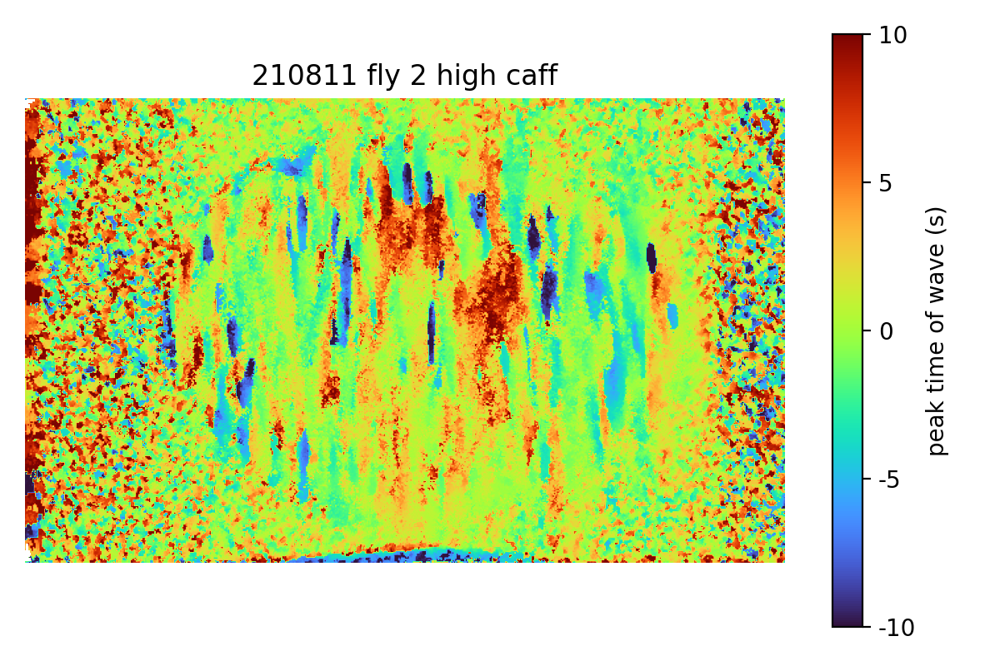

In [27]:
%matplotlib notebook
fig, ax = plt.subplots(1,1, figsize=(6,4))

im = ax.imshow(green_argmax, cmap=plt.cm.get_cmap("turbo"), clim=[-t_diff, t_diff])
ax.axis("off")
cbar = fig.colorbar(im)
cbar.set_ticks([-t_diff, -0.5*t_diff, 0, 0.5*t_diff, t_diff])
cbar.set_ticklabels([-10, -5, 0, 5, 10])
cbar.set_label("peak time of wave (s)")
ax.set_title(condition)
fig.tight_layout()

In [28]:
time_points = []
all_time_points = []
for i_loc, loc_masks in enumerate(roi_masks):
    tmp_time_points = []
    for i_mask, mask in enumerate(loc_masks):
        signal = np.sum(greens[i_trial]*mask, axis=(1,2))/np.sum(mask)
        signal_filt = gaussian_filter1d(signal, sigma=16*2)[time_range[0]:time_range[1]]
        argmax = np.argmax(signal_filt)
        tmp_time_points.append(argmax+time_range[0])
    time_points.append(np.median(tmp_time_points).astype(int))
    all_time_points.append(tmp_time_points)

In [29]:
print(all_time_points)
print(time_points)
print(global_max)

[[289, 289, 289, 511, 476], [443, 451], [484], [540, 570]]
[289, 447, 484, 555]
449


In [30]:
green_filt = gaussian_filter1d(green, sigma=3, axis=0)
min_quant = np.quantile(green_filt, 0.01, axis=0)
green_norm = (green_filt - min_quant) / (np.quantile(green_filt, 0.99, axis=0) - np.quantile(green_filt, 0.01, axis=0))

In [31]:
def global_colorbar(fig, mappable, colorbar_fraction=0.1, colorbar_label="", cbarticks=None, cbarticklabels=None):
    fig.subplots_adjust(right=1-colorbar_fraction)  # 0.8
    cbar_ax = fig.add_axes([1-colorbar_fraction+colorbar_fraction/6, 0.15, colorbar_fraction/6, 0.7])  # [0.85, 0.15, 0.05, 0.7])
    cbar = fig.colorbar(mappable, cax=cbar_ax)
    cbar.set_label(colorbar_label)
    if cbarticks is not None:
        cbar.set_ticks(cbarticks)
    if cbarticklabels is not None:
        cbar.set_ticklabels(cbarticklabels)
    return cbar

<IPython.core.display.Javascript object>


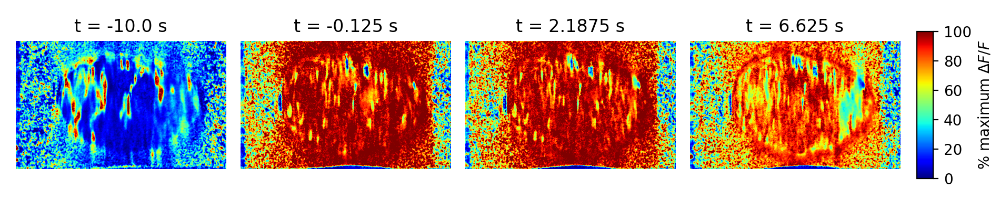

In [32]:
%matplotlib notebook
fig, axs = plt.subplots(1,4,figsize=(9.5,2))
for i_t, (ax, time_point) in enumerate(zip(axs, time_points)):
    t_rel = (time_point - global_max)/16
    im = ax.imshow(100*green_norm[time_point, :, :], clim=[0,100], cmap=plt.cm.get_cmap("jet"))
    ax.set_title(f"t = {t_rel} s")
    ax.axis("off")
fig.tight_layout()
cbar = global_colorbar(fig, im)
# cbar = fig.colorbar(im)
cbar.set_label(r"% maximum $\Delta F/F$")
# fig.tight_layout()

# new PCA plots with only CC area

In [161]:
from longterm.analysis import InterPCAAnalysis, InterPCAAnalysisFromFile
from longterm import analysis as an

In [202]:
def plot_maps(self, map_type="rest", quant=0.99, same_lim=True):
    if len(self.pixels_i_sort) > np.sum(pcan.selected_pixels):
        self.pixels_i_sort = np.arange(self.pixels[0].shape[1])
    if map_type == "rest":
        W = self.w_inter_pca_rest_pixels
    elif map_type == "walk":
        W = self.w_inter_pca_walk_pixels
    elif map_type == "walkrest":
        W = self.w_inter_pca_walk_rest_pixels
    else:
        return

    N_trials = W.shape[0]
    
    clims = []

    fig, axs = plt.subplots(N_trials-1, N_trials-1, figsize=(5*(N_trials-1), 3.5*(N_trials-1)))
    for i_col, axs_ in enumerate(axs):
        for i_row, ax in enumerate(axs_):
            if i_row < i_col:
                ax.axis("off")
                continue
            else:
                i_1 = i_col
                i_2 = i_row + 1
            W_toshow = np.nan_to_num(self.pixels_to_image(W[i_1,i_2]))
            # W_toshow[W_toshow == None] = 0
            print(W_toshow)
            clim = np.quantile(W_toshow[W_toshow!=0], quant)
            clims.append(clim)
            ax.imshow(W_toshow, cmap=plt.cm.get_cmap("seismic"), clim=[-clim, clim])
            if not same_lim:
                ax.set_title(f"{self.trial_names[i_1]} vs {self.trial_names[i_2]}\n\nlim: {clim}")
            else:
                ax.set_title(f"{self.trial_names[i_1]} vs {self.trial_names[i_2]}")
    if same_lim:
        clim = np.mean(clims)
        for ax in axs.flatten():
            if len(ax.images):
                ax.images[0].set_clim(-clim, clim)
        axs[np.min([1,N_trials-1]),0].set_title(f"clim: {clim}")
    fig.suptitle(self.condition)
    return fig

In [184]:
pcan.w_inter_pca_rest_pixels[0,0].shape

(86685,)

In [186]:
np.sum(pcan.selected_pixels)

86685

In [189]:
pcan.pixels_i_sort = np.arange(pcan.pixels[0].shape[1])

In [218]:
# for i_trials, fly_dir, condition in tqdm(zip(all_selected_trials, fly_dirs, conditions)):
# 4,5,6,7 12...15
i_fly = 4
fly_dir = fly_dirs[i_fly]
condition = conditions[i_fly]
# if "caff" in condition:
#     continue
pcan = InterPCAAnalysisFromFile(os.path.join(fly_dir, load.PROCESSED_FOLDER, "pcan.pkl"))
mask = utils.get_stack(os.path.join(fly_dir, "processed", "cc_mask.tif")) > 0
print("selecting pixels")
pcan.select_pixels(mask.flatten().astype(bool))
print("computing weights")
pcan.get_inter_pca_trials_pixels()



loading from file:  /mnt/NAS2/LH/210718/fly2/processed/pcan.pkl
selecting pixels
computing weights


<IPython.core.display.Javascript object>


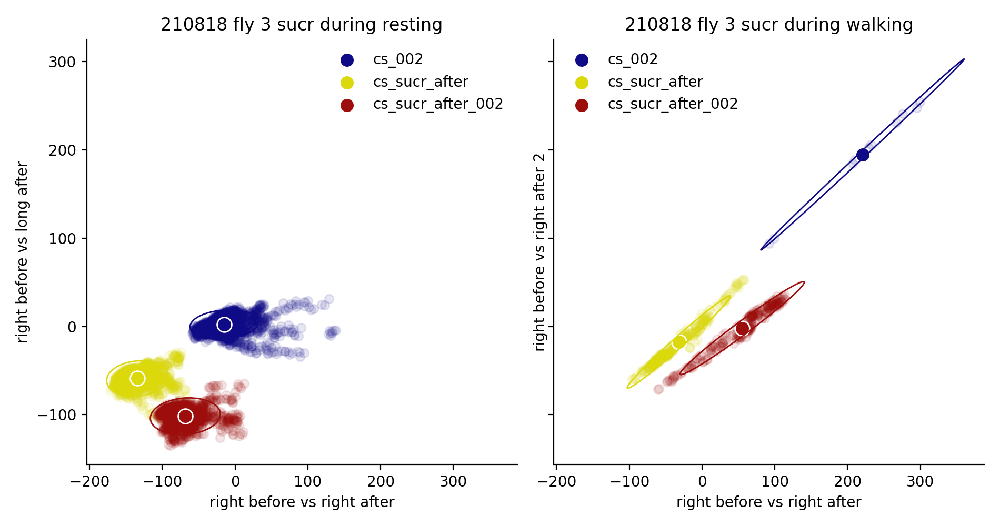

In [179]:
%matplotlib notebook

# colors_long = [myplt.BLACK, myplt.DARKBLUE, myplt.DARKGREEN, myplt.DARKYELLOW, myplt.DARKORANGE, myplt.DARKRED]
# colors_contrast_long = [myplt.DARKGRAY, myplt.DARKBLUE_CONTRAST, myplt.DARKGREEN_CONTRAST, myplt.DARKPINK, myplt.DARKPURPLE, myplt.DARKBROWN]
colors_long = [myplt.DARKBLUE,  # myplt.DARKBLUE_CONTRAST, 
               # myplt.DARKGREEN_CONTRAST, myplt.DARKGREEN, 
               myplt.DARKYELLOW, myplt.DARKRED]  # , myplt.DARKPURPLE, myplt.DARKBROWN, myplt.DARKGRAY]
colors_contrast_long = colors_long
# colors = [myplt.DARKBLUE, myplt.DARKYELLOW, myplt.DARKRED]
# colors_contrast = [myplt.DARKBLUE_CONTRAST,myplt.DARKPINK, myplt.DARKBROWN]
# order = [0,4,1,5,2,3]

fig, axs = plt.subplots(1,2, figsize=(9.5,5), sharey=True, sharex=True)  # , sharex="col", sharey="col")

short_bef = 0
right_aft = 1
med_aft = 2
long_aft = 2
trials = range(3)  # range(11)

an.plot_proj_scatter(w_1=pcan.w_inter_pca_rest_pixels[short_bef,right_aft], w_2=pcan.w_inter_pca_rest_pixels[short_bef,long_aft],
             X_trials=pcan.pixels_rest, trials=trials, w_names=["right before vs right after", "right before vs long after"],
             X_names=pcan.trial_names, 
             fig=fig, ax=axs[0], alpha=0.1, name=pcan.condition+" during resting",colors=colors_contrast_long)

an.plot_proj_scatter(w_1=pcan.w_inter_pca_walk_pixels[short_bef,right_aft], w_2=pcan.w_inter_pca_walk_pixels[short_bef,long_aft],
             X_trials=pcan.pixels_walk, trials=trials, w_names=["right before vs right after", "right before vs right after 2"],
             X_names=pcan.trial_names, 
             fig=fig, ax=axs[1], alpha=0.1, name=pcan.condition+" during walking",colors=colors_long)

# fig.suptitle("Inter Condition PCA")
# fig.tight_layout()

In [182]:
np.mean(pcan.selected_pixels)

0.42754202178030304

<IPython.core.display.Javascript object>


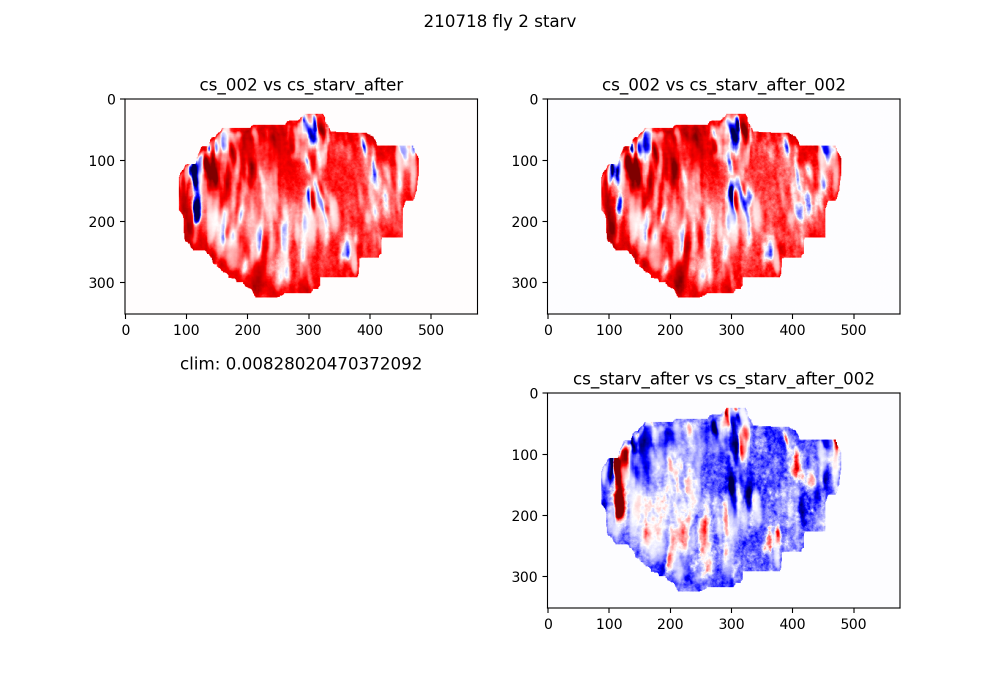

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


In [219]:
%matplotlib notebook

fig = plot_maps(pcan)

In [217]:
%matplotlib notebook